In [1]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK.
import kagglehub
loli_path = kagglehub.dataset_download('tanvirnwu/loli-street-low-light-image-enhancement-of-street')

print('Data source import complete.')

Data source import complete.


In [2]:
import os

In [3]:
os.listdir(loli_path)

['LoLI-Street Dataset']

In [4]:
loli_path = os.path.join(loli_path, "LoLI-Street Dataset")

In [5]:
import os
from torch.utils.data import Dataset
from PIL import Image
from torchvision import transforms

class LowLightDataset(Dataset):
    def __init__(self, root_dir, transform=None):
        """
        Args:
            root_dir (str): Path to the root directory containing 'low' and 'high' folders.
            transform (callable, optional): Optional transform to be applied on a sample.
        """
        self.root_dir = root_dir
        self.transform = transform

        # Get the list of low and high image filenames
        self.low_dir = os.path.join(root_dir, 'low')
        self.high_dir = os.path.join(root_dir, 'high')

        # Ensure the filenames in 'low' and 'high' directories match
        self.low_images = sorted(os.listdir(self.low_dir))
        self.high_images = sorted(os.listdir(self.high_dir))

        # Verify that the filenames match
        assert self.low_images == self.high_images, "Low and high image filenames do not match!"

    def __len__(self):
        return len(self.low_images)

    def __getitem__(self, idx):
        # Load low and high images
        low_image_path = os.path.join(self.low_dir, self.low_images[idx])
        high_image_path = os.path.join(self.high_dir, self.high_images[idx])

        low_image = Image.open(low_image_path).convert('RGB')
        high_image = Image.open(high_image_path).convert('RGB')

        # Apply transformations if any
        if self.transform:
            low_image = self.transform(low_image)
            high_image = self.transform(high_image)

        return low_image, high_image

In [6]:
# Define transformations
transform = transforms.Compose([
    transforms.Resize((256, 256)),  # Resize images to a fixed size
    transforms.ToTensor(),          # Convert images to PyTorch tensors
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))  # Normalize to [-1, 1]
])

In [7]:
import torch

# Define paths
train_path = os.path.join(loli_path, 'Train')
test_path = os.path.join(loli_path, 'Test')
val_path = os.path.join(loli_path, 'Val')

# Create datasets
train_dataset = LowLightDataset(root_dir=train_path, transform=transform)
val_dataset = LowLightDataset(root_dir=val_path, transform=transform)

train_dataset = torch.utils.data.Subset(train_dataset, range(5000))
val_dataset = torch.utils.data.Subset(val_dataset, range(500))

In [8]:
from torch.utils.data import DataLoader

# Define batch size
batch_size = 32

# Create dataloaders
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

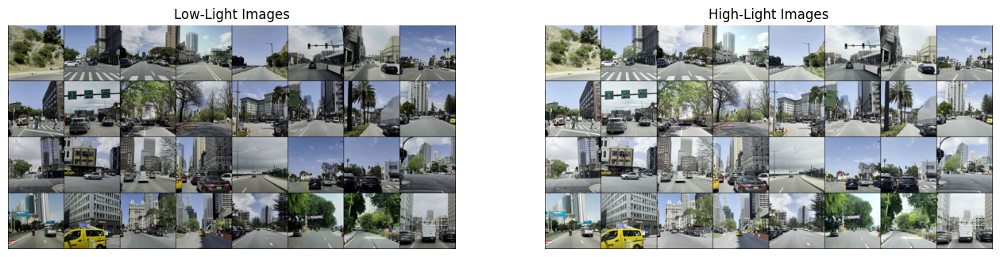

In [9]:
import matplotlib.pyplot as plt
import torchvision.utils as vutils

# Get a batch of data
low_images, high_images = next(iter(train_dataloader))

# Create a figure with two subplots
fig, axes = plt.subplots(1, 2, figsize=(16, 16))

# Display Low-Light Images
axes[0].set_title("Low-Light Images")
axes[0].imshow(vutils.make_grid(low_images, nrow=8, normalize=True).permute(1, 2, 0))
axes[0].axis("off")

# Display High-Light Images
axes[1].set_title("High-Light Images")
axes[1].imshow(vutils.make_grid(high_images, nrow=8, normalize=True).permute(1, 2, 0))
axes[1].axis("off")

plt.show()


In [10]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class UNetGenerator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3, num_residual=9):  # Increased num_residual
        super(UNetGenerator, self).__init__()

        # Initial Convolution
        self.initial = nn.Sequential(
            nn.ReflectionPad2d(3),
            nn.Conv2d(in_channels, 64, kernel_size=7, padding=0),
            nn.InstanceNorm2d(64),
            nn.ReLU(True)
        )

        # Enhanced Downsampling with more channels
        self.down1 = DownBlock(64, 128)    # /2
        self.down2 = DownBlock(128, 256)   # /4
        self.down3 = DownBlock(256, 512)   # /8
        self.down4 = DownBlock(512, 512)

        # Bottleneck with more Efficient Residual Blocks
        self.bottleneck = nn.Sequential(*[
            EfficientResidualBlock(512) for _ in range(num_residual)
        ])

        # Enhanced Upsampling with Attention-Guided Skip Connections
        self.up1 = UpBlock(512, 512, 512)
        self.up2 = UpBlock(512, 256, 512)    # /8
        self.up3 = UpBlock(256, 128, 256)    # /4
        self.up4 = UpBlock(128, 64, 128)     # /2

        # Output Layer
        self.output = nn.Sequential(
            nn.ReflectionPad2d(3),
            nn.Conv2d(64, out_channels, kernel_size=7, padding=0),
            nn.Tanh()
        )

    def forward(self, x):
        # Initial convolution
        x = self.initial(x)

        # Downsampling with skip connections
        d1 = self.down1(x)   # 128
        d2 = self.down2(d1)  # 256
        d3 = self.down3(d2)  # 512
        d4 = self.down4(d3)

        # Bottleneck processing
        x = self.bottleneck(d4)

        # Upsampling with attention-guided skip connections
        x = self.up1(x, d4)   # 512
        x = self.up2(x, d3)   # 256
        x = self.up3(x, d2)   # 128
        x = self.up4(x, d1)   # 64

        return self.output(x)

class DownBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(DownBlock, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=2, padding=1),
            nn.InstanceNorm2d(out_channels),
            nn.ReLU(True)
        )
        self.attention = EnhancedChannelSpatialAttention(out_channels)  # Enhanced attention

    def forward(self, x):
        x = self.conv(x)
        x = self.attention(x)
        return x

class UpBlock(nn.Module):
    def __init__(self, in_channels, out_channels, skip_channels):
        super(UpBlock, self).__init__()
        self.up = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='nearest'),  # Lightweight upsampling
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1),
            nn.InstanceNorm2d(out_channels),
            nn.ReLU(True)
        )
        self.attention = EnhancedChannelSpatialAttention(out_channels + skip_channels)  # Enhanced attention
        self.conv = nn.Sequential(
            nn.Conv2d(out_channels + skip_channels, out_channels, kernel_size=3, padding=1),
            nn.InstanceNorm2d(out_channels),
            nn.ReLU(True)
        )

    def forward(self, x, skip):
        x = self.up(x)
        skip_resized = F.interpolate(skip, size=x.shape[2:], mode='bilinear', align_corners=False)
        x = torch.cat([x, skip_resized], dim=1)
        x = self.attention(x)  # Attention-guided feature fusion
        return self.conv(x)

class EfficientResidualBlock(nn.Module):
    def __init__(self, channels):
        super(EfficientResidualBlock, self).__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(channels, channels, kernel_size=3, padding=1, groups=channels),
            nn.Conv2d(channels, channels, kernel_size=1),
            nn.InstanceNorm2d(channels),
            nn.ReLU(True),
            nn.Conv2d(channels, channels, kernel_size=3, padding=1, groups=channels),
            nn.Conv2d(channels, channels, kernel_size=1),
            nn.InstanceNorm2d(channels)
        )
        self.attention = EnhancedChannelSpatialAttentionWithSE(channels)  # Use combined attention

    def forward(self, x):
        residual = x
        x = self.conv(x)
        x = self.attention(x)  # Apply combined attention
        return x + residual

class EnhancedChannelAttention(nn.Module):
    def __init__(self, channels, reduction=16):  # Increased reduction ratio
        super(EnhancedChannelAttention, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.max_pool = nn.AdaptiveMaxPool2d(1)

        self.fc = nn.Sequential(
            nn.Linear(channels, channels // reduction),
            nn.ReLU(True),
            nn.Linear(channels // reduction, channels)
        )
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        b, c, _, _ = x.size()
        avg = self.avg_pool(x).view(b, c)
        max = self.max_pool(x).view(b, c)

        avg_out = self.fc(avg).view(b, c, 1, 1)
        max_out = self.fc(max).view(b, c, 1, 1)

        out = avg_out + max_out
        return x * self.sigmoid(out)

class EnhancedSpatialAttention(nn.Module):
    def __init__(self):
        super(EnhancedSpatialAttention, self).__init__()
        self.conv = nn.Conv2d(2, 1, kernel_size=7, padding=3)
        self.sigmoid = nn.Sigmoid()

    def forward(self, x):
        avg = torch.mean(x, dim=1, keepdim=True)
        max, _ = torch.max(x, dim=1, keepdim=True)
        combined = torch.cat([avg, max], dim=1)
        att = self.conv(combined)
        return x * self.sigmoid(att)
        

class EnhancedChannelSpatialAttention(nn.Module):
    def __init__(self, channels, reduction=16):  # Increased reduction ratio
        super(EnhancedChannelSpatialAttention, self).__init__()
        self.channel_att = EnhancedChannelAttention(channels, reduction)
        self.spatial_att = EnhancedSpatialAttention()

    def forward(self, x):
        x = self.channel_att(x)
        x = self.spatial_att(x)
        return x

class SEBlock(nn.Module):
    def __init__(self, channels, reduction=16):
        super(SEBlock, self).__init__()
        self.avg_pool = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Sequential(
            nn.Linear(channels, channels // reduction),
            nn.ReLU(inplace=True),
            nn.Linear(channels // reduction, channels),
            nn.Sigmoid()
        )

    def forward(self, x):
        b, c, _, _ = x.size()
        y = self.avg_pool(x).view(b, c)
        y = self.fc(y).view(b, c, 1, 1)
        return x * y


class EnhancedChannelSpatialAttentionWithSE(nn.Module):
    def __init__(self, channels, reduction=16):
        super(EnhancedChannelSpatialAttentionWithSE, self).__init__()
        self.channel_spatial_att = EnhancedChannelSpatialAttention(channels, reduction)
        self.se_att = SEBlock(channels, reduction)  # Add SE block
        self.combine = nn.Conv2d(channels * 2, channels, kernel_size=1)  # Combine features

    def forward(self, x):
        att1 = self.channel_spatial_att(x)  # Apply channel-spatial attention
        att2 = self.se_att(x)  # Apply SE attention
        combined = torch.cat([att1, att2], dim=1)  # Concatenate outputs
        return self.combine(combined)  # Combine features

In [11]:
class PatchGANDiscriminator(nn.Module):
    def __init__(self, in_channels=3):
        super().__init__()
        self.model = nn.Sequential(
            nn.utils.spectral_norm(nn.Conv2d(in_channels, 64, 4, stride=2, padding=1)),
            nn.LeakyReLU(0.2),

            nn.utils.spectral_norm(nn.Conv2d(64, 128, 4, stride=2, padding=1)),
            nn.InstanceNorm2d(128),
            nn.LeakyReLU(0.2),

            nn.utils.spectral_norm(nn.Conv2d(128, 256, 4, stride=2, padding=1)),
            nn.InstanceNorm2d(256),
            nn.LeakyReLU(0.2),

            nn.utils.spectral_norm(nn.Conv2d(256, 512, 4, stride=1, padding=1)),
            nn.InstanceNorm2d(512),
            nn.LeakyReLU(0.2),

            nn.utils.spectral_norm(nn.Conv2d(512, 1, 4, stride=1, padding=1)),
            nn.Dropout2d(0.3)
        )

    def forward(self, x):
        return self.model(x)

In [12]:
!pip install pytorch_msssim

In [13]:
import os
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.tensorboard import SummaryWriter
from torch.cuda.amp import GradScaler, autocast
from tqdm import tqdm

# Initialize TensorBoard
writer = SummaryWriter(log_dir="/kaggle/working/runs/experiment_name")

# Function to Load Checkpoints with Partial Matching
def load_checkpoint(path, generator, discriminator, device):
    checkpoint = torch.load(path, map_location=device)

    # Load model states with partial matching
    generator_state_dict = checkpoint['generator']
    discriminator_state_dict = checkpoint['discriminator']
    
    generator_dict = generator.state_dict()
    discriminator_dict = discriminator.state_dict()

    # Load only matching weights
    generator_state_dict = {k: v for k, v in generator_state_dict.items() if k in generator_dict}
    discriminator_state_dict = {k: v for k, v in discriminator_state_dict.items() if k in discriminator_dict}

    generator_dict.update(generator_state_dict)
    discriminator_dict.update(discriminator_state_dict)

    generator.load_state_dict(generator_dict, strict=False)
    discriminator.load_state_dict(discriminator_dict, strict=False)

    print(f"Checkpoint {path} loaded successfully with partial matching!")

    return checkpoint['epoch']  # Return last completed epoch


# Training Loop with Full Checkpoint Support
def train(generator, discriminator, dataloader, optimizer_G, optimizer_D, device, 
          start_epoch=0, epochs=100, checkpoint_dir="/kaggle/working/checkpoints"):
    
    os.makedirs(checkpoint_dir, exist_ok=True)
    
    criterion_GAN = nn.BCEWithLogitsLoss().to(device)
    scaler = GradScaler()
    accumulation_steps = 4
    lambda_L1 = 100

    # Wrap with DataParallel if multiple GPUs are available
    if torch.cuda.device_count() > 1:
        generator = nn.DataParallel(generator)
        discriminator = nn.DataParallel(discriminator)

    for epoch in range(start_epoch, start_epoch + epochs):
        total_loss_D, total_loss_G, total_loss_GAN, total_loss_L1 = 0, 0, 0, 0
        current_epoch_in_session = epoch - start_epoch + 1
        
        with tqdm(dataloader, desc=f"Session Epoch {current_epoch_in_session}/{epochs} (Global {epoch+1})",
                  unit="batch") as pbar:
            for i, (low_imgs, high_imgs) in enumerate(pbar):
                low_imgs, high_imgs = low_imgs.to(device), high_imgs.to(device)

                # Train Discriminator
                with autocast():
                    fake_imgs = generator(low_imgs).detach()
                    real_loss = criterion_GAN(discriminator(high_imgs), torch.ones_like(discriminator(high_imgs)))
                    fake_loss = criterion_GAN(discriminator(fake_imgs), torch.zeros_like(discriminator(fake_imgs)))
                    loss_D = (real_loss + fake_loss) / 2
                scaler.scale(loss_D).backward()
                if (i + 1) % accumulation_steps == 0:
                    scaler.step(optimizer_D)
                    scaler.update()
                    optimizer_D.zero_grad()

                # Train Generator
                with autocast():
                    fake_imgs = generator(low_imgs)
                    loss_GAN = criterion_GAN(discriminator(fake_imgs), torch.ones_like(discriminator(fake_imgs)))
                    loss_L1 = F.l1_loss(fake_imgs, high_imgs)
                    loss_G = loss_GAN + lambda_L1 * loss_L1
                scaler.scale(loss_G).backward()
                if (i + 1) % accumulation_steps == 0:
                    scaler.step(optimizer_G)
                    scaler.update()
                    optimizer_G.zero_grad()

                # Track losses
                total_loss_D += loss_D.item()
                total_loss_G += loss_G.item()
                total_loss_GAN += loss_GAN.item()
                total_loss_L1 += loss_L1.item()

                # Update tqdm display
                pbar.set_postfix({
                    "Loss D": f"{loss_D.item():.4f}",
                    "Loss G": f"{loss_G.item():.4f}",
                    "GAN": f"{loss_GAN.item():.4f}",
                    "L1": f"{loss_L1.item():.4f}"
                })

                # Free memory
                del fake_imgs, loss_D, loss_G, loss_GAN, loss_L1

            # Log losses after each epoch
            writer.add_scalar("Loss/Discriminator", total_loss_D / len(dataloader), epoch)
            writer.add_scalar("Loss/Generator", total_loss_G / len(dataloader), epoch)
            writer.add_scalar("Loss/GAN", total_loss_GAN / len(dataloader), epoch)
            writer.add_scalar("Loss/L1", total_loss_L1 / len(dataloader), epoch)

            print(f"Session Epoch [{current_epoch_in_session}/{epochs}] (Global {epoch+1}) "
                  f"Loss D: {total_loss_D / len(dataloader):.4f}, "
                  f"Loss G: {total_loss_G / len(dataloader):.4f}, "
                  f"GAN: {total_loss_GAN / len(dataloader):.4f}, "
                  f"L1: {total_loss_L1 / len(dataloader):.4f}")

        # Save full checkpoint every 5 epochs
        if (epoch + 1) % 5 == 0:
            checkpoint = {
                'epoch': epoch + 1,
                'generator': generator.module.state_dict() if isinstance(generator, nn.DataParallel) else generator.state_dict(),
                'discriminator': discriminator.module.state_dict() if isinstance(discriminator, nn.DataParallel) else discriminator.state_dict(),
                'optimizer_G': optimizer_G.state_dict(),
                'optimizer_D': optimizer_D.state_dict(),
            }
            torch.save(checkpoint, f"{checkpoint_dir}/checkpoint_epoch_{epoch+1}.pth")

    writer.close()

# Initialize Models
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator = UNetGenerator().to(device)
discriminator = PatchGANDiscriminator().to(device)

# Initialize Optimizers
optimizer_G = torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=0.0001, betas=(0.5, 0.999))

# Try to Load Latest Checkpoint
checkpoint_dir = "/kaggle/working/checkpoints"
checkpoint_path = f"/kaggle/input/cvpr_gan/pytorch/default/3/checkpoint_epoch_400.pth"
start_epoch = 0

if os.path.exists(checkpoint_path):
    print(f"Loading checkpoint from {checkpoint_path}")
    start_epoch = load_checkpoint(checkpoint_path, generator, discriminator, device)
    print(f"Resuming training from epoch {start_epoch}")

# Continue Training from the Loaded Checkpoint
train(generator, discriminator, train_dataloader, optimizer_G, optimizer_D,
      device, start_epoch=start_epoch, epochs=1, checkpoint_dir=checkpoint_dir)


Loading checkpoint from /kaggle/input/cvpr_gan/pytorch/default/3/checkpoint_epoch_400.pth


<ipython-input-13-e3c4ae8dad0c>:14: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(path, map_location=device)
<ipython-input-13-e3c4ae8dad0c>:45: Futu

Checkpoint /kaggle/input/cvpr_gan/pytorch/default/3/checkpoint_epoch_400.pth loaded successfully with partial matching!
Resuming training from epoch 400


Session Epoch 1/1 (Global 401):   0%|          | 0/157 [00:00<?, ?batch/s]<ipython-input-13-e3c4ae8dad0c>:64: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
<ipython-input-13-e3c4ae8dad0c>:76: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with autocast():
Session Epoch 1/1 (Global 401): 100%|██████████| 157/157 [05:54<00:00,  2.26s/batch, Loss D=0.6471, Loss G=3.1470, GAN=0.5270, L1=0.0262]

Session Epoch [1/1] (Global 401) Loss D: 0.6632, Loss G: 3.1289, GAN: 0.4635, L1: 0.0267


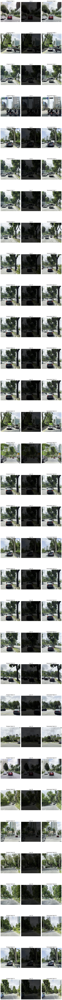

In [14]:
import torch
import matplotlib.pyplot as plt

def validate(generator, dataloader, device):
    generator.eval()

    with torch.no_grad():
        for low_imgs, high_imgs in dataloader:
            low_imgs, high_imgs = low_imgs.to(device), high_imgs.to(device)

            generated_high_imgs = generator(low_imgs)

            generated_high_imgs = generated_high_imgs.cpu().numpy()
            high_imgs = high_imgs.cpu().numpy()
            low_imgs = low_imgs.cpu().numpy()

            generated_high_imgs = (generated_high_imgs + 1) / 2
            high_imgs = (high_imgs + 1) / 2
            low_imgs = (low_imgs + 1) / 2

            num_images = len(low_imgs)
            fig, axes = plt.subplots(num_images, 3, figsize=(10, 5 * num_images))

            for i in range(num_images):
                axes[i, 0].imshow(high_imgs[i].transpose(1, 2, 0))
                axes[i, 0].set_title(f"Original High {i+1}")
                axes[i, 0].axis('off')

                axes[i, 1].imshow(low_imgs[i].transpose(1, 2, 0))
                axes[i, 1].set_title(f"Low {i+1}")
                axes[i, 1].axis('off')

                axes[i, 2].imshow(generated_high_imgs[i].transpose(1, 2, 0))
                axes[i, 2].set_title(f"Generated High {i+1}")
                axes[i, 2].axis('off')

            plt.tight_layout()
            plt.show()

            # After the first batch, stop further plotting
            break

# Perform validation over all batches (will only plot the first batch)
validate(generator, val_dataloader, device)

In [15]:
import torch

def create_img_pair(generator, dataloader, device):
    generator.eval()

    high_image_pairs = []

    with torch.no_grad():
        for low_imgs, high_imgs in dataloader:
            low_imgs, high_imgs = low_imgs.to(device), high_imgs.to(device)

            generated_high_imgs = generator(low_imgs)

            generated_high_imgs = generated_high_imgs.cpu().numpy()
            high_imgs = high_imgs.cpu().numpy()
            low_imgs = low_imgs.cpu().numpy()

            generated_high_imgs = (generated_high_imgs + 1) / 2
            high_imgs = (high_imgs + 1) / 2
            low_imgs = (low_imgs + 1) / 2

            # Create a list of tuples of original and generated high images for this batch
            batch_pairs = [(high_imgs[i], generated_high_imgs[i]) for i in range(len(low_imgs))]
            high_image_pairs.extend(batch_pairs)

    return high_image_pairs

# Perform validation over all batches
high_image_pairs = create_img_pair(generator, val_dataloader, device)


In [16]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

generator_params = count_parameters(generator)
discriminator_params = count_parameters(discriminator)

print(f"Generator Parameters: {generator_params:,}")
print(f"Discriminator Parameters: {discriminator_params:,}")


Generator Parameters: 25,330,498
Discriminator Parameters: 2,764,737


In [17]:
!pip install fvcore

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 1.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 1.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for fvcore: filename=fvcore-0.1.5.post20221221-py3-none-any.whl size=61396 sha256=9ba8401a0da36adf7d74f001bacddf73c52b410ad71a2b65435dcf287d530521
  Stored in directory: /root/.cache/pip/wheels/01/c0/af/77c1cf53a1be9e42a52b48e5af2169d40ec2e89f7362489dd0
  Created wheel for iopath: filename=iopath-0.1.10-py3-none-any.whl size=31528 sha256=84aee83c080730c06a26df790a9f937dc0b20c216b14cfa07c970c78bccfb435
  Stored in directory: /root/.cache/pip/wheels/9a/a3/b6/ac0fcd1b4ed5cfeb3db92e6a0e476cfd48ed0df92b91080c1d
Successfully built fvcore iopath


In [18]:
from fvcore.nn import FlopCountAnalysis

# Generate a dummy input with the same shape as your real input
dummy_input = torch.randn(1, 3, 256, 256).to(device)  # Adjust based on your input size

# Compute FLOPs
flops_generator = FlopCountAnalysis(generator, dummy_input)
flops_discriminator = FlopCountAnalysis(discriminator, dummy_input)

print(f"Generator FLOPs: {flops_generator.total() / 1e9:.2f}G")  # Convert to Giga (G)
print(f"Discriminator FLOPs: {flops_discriminator.total() / 1e9:.2f}G")  # Convert to Giga (G)


Generator FLOPs: 51.61G
Discriminator FLOPs: 3.15G


In [19]:
!pip install pymetrics
!pip install lpips

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.2/53.2 kB 2.7 MB/s eta 0:00:00
  Attempting uninstall: attrs
    Found existing installation: attrs 24.3.0
    Uninstalling attrs-24.3.0:
      Successfully uninstalled attrs-24.3.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2024.10.0 requires fsspec==2024.10.0, but you have fsspec 2024.9.0 which is incompatible.
jsonschema 4.23.0 requires attrs>=22.2.0, but you have attrs 21.4.0 which is incompatible.
referencing 0.35.1 requires attrs>=22.2.0, but you have attrs 21.4.0 which is incompatible.
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 1.6 MB/s eta 0:00:00


In [20]:
import numpy as np
import torch
import lpips
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

def calculate_metrics(high_image_pairs):
    lpips_model = lpips.LPIPS(net='alex')

    psnr_values = []
    ssim_values = []
    lpips_values = []

    for idx, (gt_image, gen_image) in enumerate(high_image_pairs):
        # Convert to numpy arrays and normalize
        gt_image = np.array(gt_image).astype(np.float32) / 255.0
        gen_image = np.array(gen_image).astype(np.float32) / 255.0

        # Fix channel order (CHW -> HWC)
        if gt_image.shape[0] == 3:  # If channels-first (C,H,W)
            gt_image = np.transpose(gt_image, (1, 2, 0))
            gen_image = np.transpose(gen_image, (1, 2, 0))


        # SSIM calculation (ensure HWC format)
        height, width = gt_image.shape[:2]
        min_dim = min(height, width)
        win_size = 7 if min_dim >= 7 else (min_dim - 1) if min_dim % 2 == 0 else min_dim
        win_size = max(win_size, 3)

        ssim_value = ssim(
            gt_image,
            gen_image,
            data_range=1.0,
            channel_axis=2,
            win_size=win_size
        )

        # LPIPS tensor conversion (HWC -> CHW)
        gt_tensor = torch.from_numpy(gt_image).permute(2, 0, 1).unsqueeze(0).float()
        gen_tensor = torch.from_numpy(gen_image).permute(2, 0, 1).unsqueeze(0).float()
        

        # Calculate metrics
        psnr_values.append(psnr(gt_image, gen_image, data_range=1.0))
        ssim_values.append(ssim_value)
        lpips_values.append(lpips_model(gt_tensor, gen_tensor).item())

    return (
        np.mean(psnr_values),
        np.mean(ssim_values),
        np.mean(lpips_values)
    )

In [25]:
# Assuming high_image_pairs contains valid (ground truth, generated) image pairs
avg_psnr, avg_ssim, avg_lpips = calculate_metrics(high_image_pairs)
print(f"PSNR: {avg_psnr:.2f} dB | SSIM: {avg_ssim:.3f} | LPIPS: {avg_lpips:.3f}")

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/alex.pth
PSNR: 81.50 dB | SSIM: 1.000 | LPIPS: 0.000


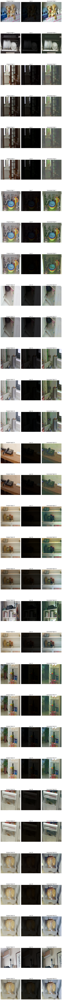

In [22]:
test_path = "/kaggle/input/lli-dataset/LLI_dataset"

# Create datasets
test_dataset = LowLightDataset(root_dir=test_path, transform=transform)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
validate(generator, test_dataloader, device)

In [23]:
test_high_image_pair = create_img_pair(generator, test_dataloader, device)

In [24]:
# Assuming high_image_pairs contains valid (ground truth, generated) image pairs
avg_psnr_test, avg_ssim_test, avg_lpips_test = calculate_metrics(test_high_image_pair)
print(f"Test Set PSNR: {avg_psnr_test:.2f} dB | Test Set SSIM: {avg_ssim_test:.3f} | Test Set LPIPS: {avg_lpips_test:.3f}")

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.10/dist-packages/lpips/weights/v0.1/alex.pth
Test Set PSNR: 66.91 dB | Test Set SSIM: 0.998 | Test Set LPIPS: 0.000
